In [1]:
# to get started, we will import these libraries
import urllib.request, json 
import pandas as pd
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
from sodapy import Socrata
import shapely
from shapely.geometry import shape

# For spatial statistics
import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation
import libpysal as lps

# Graphics
import plotly.express as px

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [2]:
# next we will connect to the data portal to load in vacant parcel data from LA County Assessor
client = Socrata("data.lacounty.gov", None)

# The website says this dataset has 176K rows, we are going to try to call in all of them using 180K in case more have been added. However, we are also going to limit our data to Los Angeles incorporated
results = client.get("vcaw-zeg9", limit=180000, where="taxratearea_city=='LOS ANGELES'")

# We'll need to convert to pandas DataFrame
vacdf = pd.DataFrame.from_records(results)

vacdf.sample(5)

,usecodedescchar1,roll_homeownersexemp,situsunit,recordingdate,effectiveyearbuilt,istaxableparcel,roll_totlandimp,roll_perspropexemp,parcelboundarydescription,roll_landbaseyear,...,location_1,bathrooms,sqftmain,situsdirection,roll_realestateexemp,center_lat,situszip,yearbuilt,propertylocation,situszip5
9768,Residential,0,,20000928,0,N,0,0,TR=14159 LOT 85,1996,...,"{'latitude': '33.94876365', 'needs_recoding': ...",0,0,W,0,33.94876365,90045-5711,0,5335 W 97TH ST LOS ANGELES CA 90045,90045
14099,Commercial,0,,19871117,0,Y,79463,0,WARE VILLA TR N 85.7 FT OF LOT 23 AND N 85.7 F...,1988,...,"{'latitude': '33.99852443', 'needs_recoding': ...",0,0,S,0,33.99852443,90037-3377,0,4900 S HOOVER ST LOS ANGELES CA 90037,90037
7774,Residential,0,,20131216,0,Y,11367,0,REPLAT OF A POR OF THE PROP OF THE LANKERSHIM ...,2006,...,"{'latitude': '34.12659774', 'needs_recoding': ...",0,0,,0,34.12659774,,0,NaN,NaN
5234,Residential,0,,20031124,0,Y,23654,0,TRACT NO 6408 LOT 100,2004,...,"{'latitude': '34.2453544', 'needs_recoding': F...",0,0,,0,34.24535440,,0,NaN,NaN
31279,Industrial,0,,19991021,0,N,0,0,TR=2016 FOR DESC SEE ASSESSORS MAP POR OF LOT ...,1975,...,"{'latitude': '33.7846566', 'needs_recoding': F...",0,0,,0,33.78465660,,0,NaN,NaN


In [3]:
# importing our community boundaries dataset by referencing API from data source and using shapely to convert the geometries

comdf = pd.read_json( r'https://data.lacounty.gov/resource/frhs-h972.json' )
comdf = comdf[comdf["lcity"].str.contains("Los Angeles") == True]
comdf['the_geom'] = comdf['the_geom'].apply(shape)
comgdf = gpd.GeoDataFrame(comdf).set_geometry('the_geom')

comgdf.sample(5)

,objectid,city_type,lcity,label,source,shape_starea,shape_stlength,the_geom,community
253,126,City,Los Angeles,Los Angeles - Pacific Palisades,LA City,1.603255e+08,86796.795315,"MULTIPOLYGON (((-118.51074 34.05111, -118.5106...",Pacific Palisades
142,91,City,Los Angeles,Los Angeles - Hancock Park,LA City,5.732301e+07,35841.960772,"MULTIPOLYGON (((-118.30915 34.07625, -118.3091...",Hancock Park
120,54,City,Los Angeles,Los Angeles - Bel Air,LA City,1.865802e+08,76705.397402,"MULTIPOLYGON (((-118.45961 34.13048, -118.4585...",Bel Air
116,78,City,Los Angeles,Los Angeles - El Sereno,LA City,1.090510e+08,57287.733092,"MULTIPOLYGON (((-118.15536 34.09867, -118.1553...",El Sereno
261,131,City,Los Angeles,Los Angeles - Park La Brea,LA City,1.334969e+07,17145.019183,"MULTIPOLYGON (((-118.34723 34.06918, -118.3472...",Park La Brea


In [4]:
vacgdf = gpd.GeoDataFrame(vacdf, 
                       crs='epsg:4326',
                       geometry=gpd.points_from_xy(vacdf.center_lon, vacdf.center_lat))

In [5]:
comgdf = comgdf.set_crs('epsg:4326')

In [6]:
# Do the spatial join
join = gpd.sjoin(vacgdf, comgdf, how='left')
join.head()

,usecodedescchar1,roll_homeownersexemp,situsunit,recordingdate,effectiveyearbuilt,istaxableparcel,roll_totlandimp,roll_perspropexemp,parcelboundarydescription,roll_landbaseyear,...,geometry,index_right,objectid,city_type,lcity,label,source,shape_starea,shape_stlength,community
0,Industrial,0,,20140123,0,Y,42410,0,OWENSMOUTH S 50 FT OF N 100 FT OF W 231.43 FT ...,1975,...,POINT (-118.59799 34.19628),85.0,61.0,City,Los Angeles,Los Angeles - Canoga Park,LA City,1.282930e+08,57957.649654,Canoga Park
1,Residential,0,,20141112,0,Y,28000,0,"*LAND DESC IN DOC 0002484, 76-4-26 *TR=22481*P...",2015,...,POINT (-118.60634 34.17791),334.0,184.0,City,Los Angeles,Los Angeles - Woodland Hills,LA City,4.113293e+08,122458.394067,Woodland Hills
2,Residential,0,,20090406,0,Y,0,0,TR=53188 FOR DESC SEE ASSESSOR'S MAPS POR OF L...,2009,...,POINT (-118.61022 34.17398),334.0,184.0,City,Los Angeles,Los Angeles - Woodland Hills,LA City,4.113293e+08,122458.394067,Woodland Hills
3,Residential,0,,20111007,0,Y,114438,0,P M 360-55-56 LOT B,2012,...,POINT (-118.54503 34.17730),301.0,153.0,City,Los Angeles,Los Angeles - Tarzana,LA City,1.790798e+08,74083.358669,Tarzana
4,Residential,0,,19970805,0,Y,391931,0,TR=36573 LOT 1,1998,...,POINT (-118.52987 34.17196),301.0,153.0,City,Los Angeles,Los Angeles - Tarzana,LA City,1.790798e+08,74083.358669,Tarzana


In [7]:
vac_by_com = join.community.value_counts().rename_axis('community').reset_index(name='parcel_count')

In [8]:
comgdf=comgdf.merge(vac_by_com,on='community')

In [9]:
comgdf = comgdf.to_crs(epsg=3857)

In [10]:
comgdf.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [11]:
comgdf['parcel_density'] = comgdf['parcel_count']/comgdf.area*10000

In [12]:
comgdf

,objectid,city_type,lcity,label,source,shape_starea,shape_stlength,the_geom,community,parcel_count,parcel_density
0,95,City,Los Angeles,Los Angeles - Harvard Heights,LA City,2.089842e+07,21077.385705,"MULTIPOLYGON (((-13168156.516 4034174.855, -13...",Harvard Heights,55,0.194010
1,55,City,Los Angeles,Los Angeles - Beverly Crest,LA City,2.342333e+08,110820.548509,"MULTIPOLYGON (((-13181063.965 4046197.142, -13...",Beverly Crest,1818,0.571221
2,135,City,Los Angeles,Los Angeles - Porter Ranch,LA City,2.283543e+08,76200.863524,"MULTIPOLYGON (((-13195918.006 4068994.839, -13...",Porter Ranch,431,0.138357
3,60,City,Los Angeles,Los Angeles - Cadillac-Corning,LA City,6.719564e+06,10707.147031,"MULTIPOLYGON (((-13177647.156 4034783.180, -13...",Cadillac-Corning,3,0.032913
4,86,City,Los Angeles,Los Angeles - Florence-Firestone,LA City,7.053592e+07,41435.669231,"MULTIPOLYGON (((-13164232.612 4027390.138, -13...",Florence-Firestone,183,0.191569
...,...,...,...,...,...,...,...,...,...,...,...
134,83,City,Los Angeles,Los Angeles - Exposition Park,LA City,7.083888e+07,41975.378939,"MULTIPOLYGON (((-13168639.695 4032227.513, -13...",Exposition Park,173,0.180139
135,177,City,Los Angeles,Los Angeles - Westchester,LA City,3.593835e+08,114680.771063,"MULTIPOLYGON (((-13175915.130 4026524.539, -13...",Westchester,939,0.193030
136,150,City,Los Angeles,Los Angeles - Sunland,LA City,1.842077e+08,108169.637522,"MULTIPOLYGON (((-13168758.485 4066300.720, -13...",Sunland,492,0.195905
137,142,City,Los Angeles,Los Angeles - Shadow Hills,LA City,8.518806e+07,49148.438347,"MULTIPOLYGON (((-13173081.385 4064545.751, -13...",Shadow Hills,194,0.167039


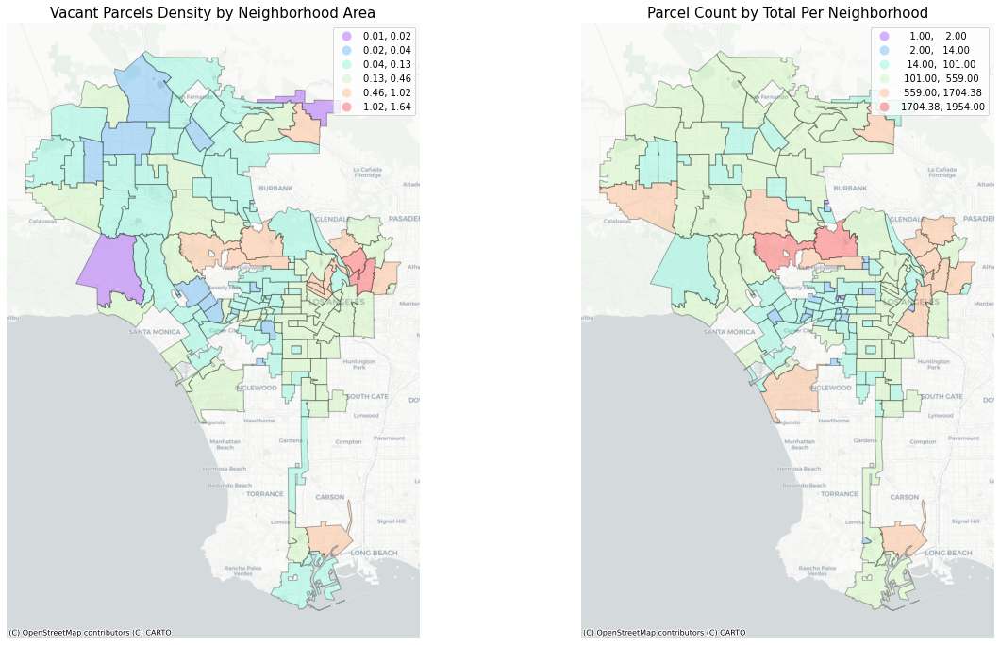

In [13]:
# create the 1x2 subplots
fig, ax = plt.subplots(1, 2, figsize=(20, 12))

# two subplots produces ax[0] (left) and ax[1] (right)

# spatial lag choropleth
comgdf.plot(ax=ax[0],
         column='parcel_density',
         legend=True,
            k=5,
         alpha=0.3,
        edgecolor='k',
         cmap='rainbow',
         scheme='percentiles')

ax[0].axis("off")
ax[0].set_title('Vacant Parcels Density by Neighborhood Area',fontsize=15)
ctx.add_basemap(ax[0],source=ctx.providers.CartoDB.Positron, crs=comgdf.crs)

# spatial lag map on the right
comgdf.plot(ax=ax[1],
         column='parcel_count', 
         cmap='rainbow', 
         scheme='percentiles',
         k=5, 
         edgecolor='k',
         alpha=0.3,
            legend=True)

ax[1].axis("off")
ax[1].set_title("Parcel Count by Total Per Neighborhood",fontsize=15)

ctx.add_basemap(ax[1],source=ctx.providers.CartoDB.Positron, crs=comgdf.crs)

In [14]:
vacgdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 33091 entries, 0 to 33090
Data columns (total 52 columns):
 #   Column                     Non-Null Count  Dtype   
---  ------                     --------------  -----   
 0   usecodedescchar1           33080 non-null  object  
 1   roll_homeownersexemp       33091 non-null  object  
 2   situsunit                  33091 non-null  object  
 3   recordingdate              33091 non-null  object  
 4   effectiveyearbuilt         33091 non-null  object  
 5   istaxableparcel            33091 non-null  object  
 6   roll_totlandimp            33091 non-null  object  
 7   roll_perspropexemp         33091 non-null  object  
 8   parcelboundarydescription  33091 non-null  object  
 9   roll_landbaseyear          33091 non-null  object  
 10  situscity                  33091 non-null  object  
 11  roll_impbaseyear           33091 non-null  object  
 12  usetype                    33080 non-null  object  
 13  cluster                

In [15]:
vacgdf_web = vacgdf.to_crs('EPSG:4326')

In [16]:
vacgdf_web = vacgdf_web.fillna('N/A')
vacgdf_web.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 33091 entries, 0 to 33090
Data columns (total 52 columns):
 #   Column                     Non-Null Count  Dtype   
---  ------                     --------------  -----   
 0   usecodedescchar1           33091 non-null  object  
 1   roll_homeownersexemp       33091 non-null  object  
 2   situsunit                  33091 non-null  object  
 3   recordingdate              33091 non-null  object  
 4   effectiveyearbuilt         33091 non-null  object  
 5   istaxableparcel            33091 non-null  object  
 6   roll_totlandimp            33091 non-null  object  
 7   roll_perspropexemp         33091 non-null  object  
 8   parcelboundarydescription  33091 non-null  object  
 9   roll_landbaseyear          33091 non-null  object  
 10  situscity                  33091 non-null  object  
 11  roll_impbaseyear           33091 non-null  object  
 12  usetype                    33091 non-null  object  
 13  cluster                

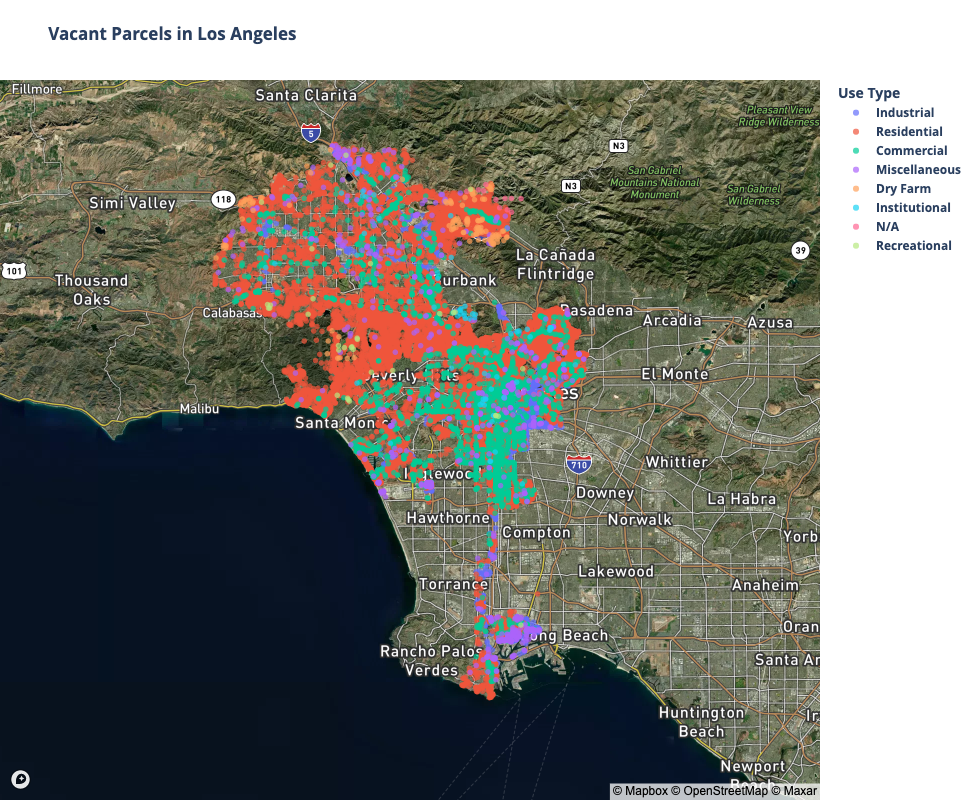

In [17]:
# set the mapbox access token
token = 'pk.eyJ1IjoieW9obWFuIiwiYSI6IkxuRThfNFkifQ.u2xRJMiChx914U7mOZMiZw'
px.set_mapbox_access_token(token)


fig = px.scatter_mapbox(vacgdf_web,
                        lat="center_lat",
                        lon="center_lon",
                        hover_name="ain",
                        opacity=.7,
                        size_max=10,
                     zoom=9, 
                     color='usecodedescchar1',labels={'usecodedescchar1':'Use Type'},title = "Vacant Parcels in Los Angeles",
                     hover_data=['usecodedescchar1','usecodedescchar1','usecodedescchar1','taxratearea_city','usetype','istaxableparcel'],
                           center = {"lat": 34, "lon": -118.4},
                     width=1000,
                     height=800)

fig.update_layout(mapbox_style="satellite-streets")
fig.update_layout(margin={"r":0,"t":80,"l":0,"b":0})


fig.show()

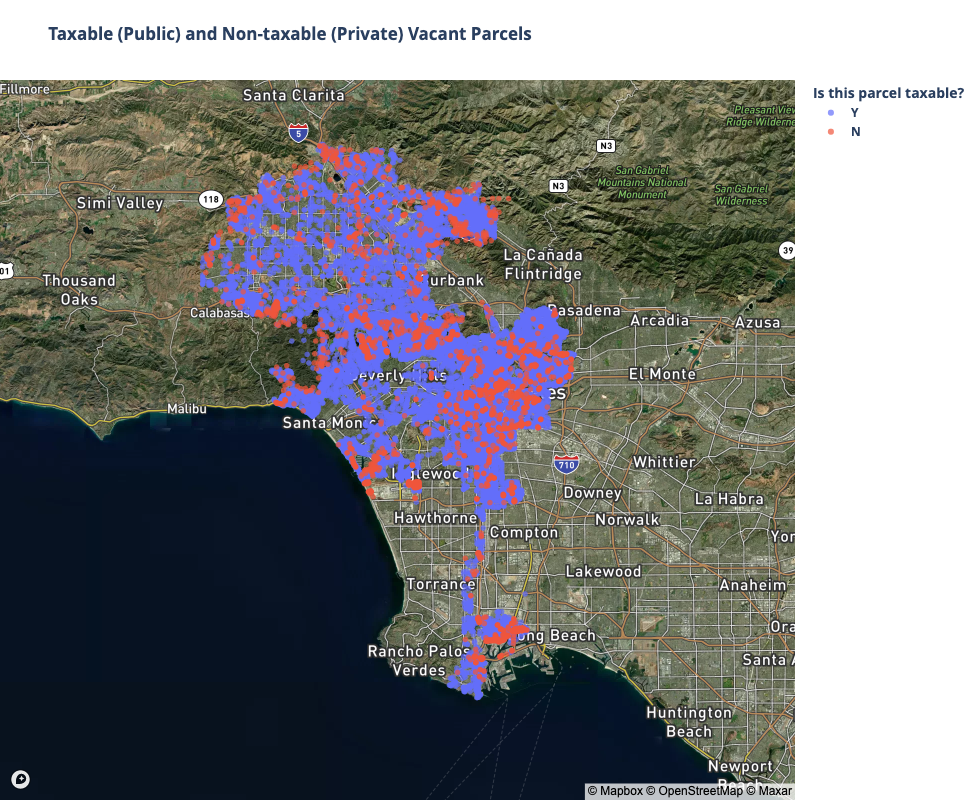

In [22]:
fig = px.scatter_mapbox(vacgdf_web,
                        lat="center_lat",
                        lon="center_lon",
                        hover_name="ain",
                        opacity=.7,
                        size_max=10,
                     zoom=9, 
                     color='istaxableparcel',labels={'istaxableparcel':'Is this parcel taxable?'},title = "Taxable (Public) and Non-taxable (Private) Vacant Parcels",
                     hover_data=['usecodedescchar1','usecodedescchar1','usecodedescchar1','taxratearea_city','usetype','istaxableparcel'],
                           center = {"lat": 34, "lon": -118.4},
                     width=950,
                     height=800)

fig.update_layout(mapbox_style="satellite-streets")
fig.update_layout(margin={"r":0,"t":80,"l":0,"b":0})
fig.show()

In [19]:
fig = px.choropleth_mapbox(comgdf_web, 
                     geojson=comgdf_web.geometry, # the geometry column
                     locations=comgdf_web.index, # the index
                     mapbox_style="satellite-streets",
                     zoom=9, 
                     color='percent_lag',
                     color_continuous_scale='RdYlGn_r',
                           color_continuous_midpoint = 0.425, # put the median as the midpoint
                     range_color =(0,0.425*2),
                     hover_data=['community','total_parcels','parcel_count','percent','percent_lag'],
                     center = {"lat": center_lat_comgdf_web, "lon": center_lon_comgdf_web},
                     opacity=0.5,
                     width=1000,
                     height=800,
                     labels={
                             'percent_lag':'Vacant Parcel Percentages (Spatial Lag)',
                             'percent':'Vacant Parcel Percentages',
                     })
fig.update_traces(marker_line_width=0.1, marker_line_color='white')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

NameError: name 'comgdf_web' is not defined